# Introduction

Herein we'll analyse Covid-19 data sets of South Korea. The notebook will provide and describe steps of data cleaning, data preprocessing, exploratory data analysis, visualizations, comparisons, correlation calculations and finalise with giving improvements and conclusion.

In [1]:
# Importing libraries

import pandas as pd
import numpy as np
import os
from datetime import datetime
import time
from time import mktime
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as ss
import itertools
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import davies_bouldin_score
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn import metrics
import matplotlib.pyplot as plt
from statistics import mean
import matplotlib.pyplot as plt     
import plotly.offline as py       
from plotly.subplots import make_subplots
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from matplotlib.pyplot import figure, show
import warnings
warnings.filterwarnings('ignore')
from IPython.display import HTML
import matplotlib.colors as mc
import colorsys
from random import randint
import re
import missingno as msno
from scipy import stats
from mlxtend.preprocessing import minmax_scaling
from typing import Union
from wordcloud import WordCloud, STOPWORDS
from plotly.offline import iplot
import warnings
warnings.filterwarnings('ignore')

# The Lists of Data Table

**1) Case Data**

* **Case**: Data of COVID-19 infection cases in South Korea

**2) Patient Data**

* **PatientInfo**: Epidemiological data of COVID-19 patients in South Korea

**3) Time Series Data**

* **Time**: Time series data of COVID-19 status in South Korea
* **TimeAge**: Time series data of COVID-19 status in terms of the age in South Korea
* **TimeGender**: Time series data of COVID-19 status in terms of gender in South Korea
* **TimeProvince**: Time series data of COVID-19 status in terms of the Province in South Korea

**4) Additional Data**

* **Region**: Location and statistical data of the regions in South Korea
* **Weather**: Data of the weather in the regions of South Korea
* **SearchTrend**: Trend data of the keywords searched in NAVER which is one of the largest portals in South Korea
* **SeoulFloating**: Data of floating population in Seoul, South Korea (from SK Telecom Big Data Hub)
* **Policy**: Data of the government policy for COVID-19 in South Korea

<i> Before we Start.. </i>

* We make a structured dataset based on the report materials of KCDC and local governments.
* In Korea, we use the terms named '-do', '-si', '-gun' and '-gu',
* The meaning of them are explained below.

Levels of administrative divisions in South Korea

Upper Level (Provincial-level divisions)

* **Special City**: Seoul
* **Metropolitan City**: Busan / Daegu / Daejeon / Gwangju / Incheon / Ulsan
* **Province(-do)**: Gyeonggi-do / Gangwon-do / Chungcheongbuk-do / Chungcheongnam-do / Jeollabuk-do / Jeollanam-do / Gyeongsangbuk-do / Gyeongsangnam-do

Lower Level (Municipal-level divisions)

* **City(-si)** [List of cities in South Korea](https://en.wikipedia.org/wiki/List_of_cities_in_South_Korea)
* **Country(-gun)** [List of counties of South Korea](https://en.wikipedia.org/wiki/List_of_counties_of_South_Korea)
* **District(-gu)** [List of districts in South Korea](https://en.wikipedia.org/wiki/List_of_districts_in_South_Korea)

<img src="us_hi_30-1.jpg" alt="Alt text that describes the graphic" title="Title text" />

Sources

* http://nationalatlas.ngii.go.kr/pages/page_1266.php
* https://en.wikipedia.org/wiki/Administrative_divisions_of_South_Korea


## Loading data

In [2]:
# Defining path

path = '/Users/Aurimas/Documents/Python/TC_projects/Covid-19/'

# Assignments of various data sets

case = p_info = pd.read_csv(path+'Case.csv')
patient_info = pd.read_csv(path+'PatientInfo.csv')
time = pd.read_csv(path+'Time.csv')
time_age = pd.read_csv(path+'TimeAge.csv')
time_gender = pd.read_csv(path+'TimeGender.csv')
time_province = pd.read_csv(path+'TimeProvince.csv')
region = pd.read_csv(path+'Region.csv')
weather = pd.read_csv(path+'Weather.csv')
search = pd.read_csv(path+'SearchTrend.csv')
floating = pd.read_csv(path+'SeoulFloating.csv')
policy = pd.read_csv(path+'Policy.csv')

patient_info.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50s,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released


In [3]:
# patient_info['age'] = patient_info['age'].str.replace('s','')
# # patient_info['age'] = patient_info['age'].map(lambda x: eval(x))
# patient_info.head()

## Data cleaning

In the below cells we are investigating if any value in the rows of features at a dataframe is null or nan and how many such values there are. Then plotting the data and identifying numerical with categorical features of each data analysed.

In [10]:
# Case data cleaning

for col in case.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (case[col].isnull().sum() / case[col].shape[0]))
    print(msg)

column:    case_id	 Percent of NaN value: 0.00%
column:   province	 Percent of NaN value: 0.00%
column:       city	 Percent of NaN value: 0.00%
column:      group	 Percent of NaN value: 0.00%
column: infection_case	 Percent of NaN value: 0.00%
column:  confirmed	 Percent of NaN value: 0.00%
column:   latitude	 Percent of NaN value: 0.00%
column:  longitude	 Percent of NaN value: 0.00%


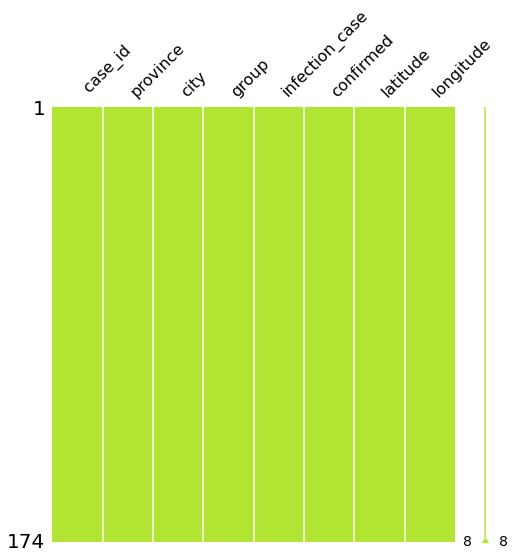

In [11]:
# Plotting null data of case data

msno.matrix(df=case.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [12]:
# Which features are numeric ?

cols = case.columns
num_cols = case._get_numeric_data().columns
num_cols

# df.info()

Index([' case_id', 'group', 'confirmed'], dtype='object')

In [13]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

# df.dtypes.value_counts()

['infection_case', 'city', 'latitude', 'longitude', 'province']

In [14]:
# Region data cleaning

for col in region.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (region[col].isnull().sum() / region[col].shape[0]))
    print(msg)

column:       code	 Percent of NaN value: 0.00%
column:   province	 Percent of NaN value: 0.00%
column:       city	 Percent of NaN value: 0.00%
column:   latitude	 Percent of NaN value: 0.00%
column:  longitude	 Percent of NaN value: 0.00%
column: elementary_school_count	 Percent of NaN value: 0.00%
column: kindergarten_count	 Percent of NaN value: 0.00%
column: university_count	 Percent of NaN value: 0.00%
column: academy_ratio	 Percent of NaN value: 0.00%
column: elderly_population_ratio	 Percent of NaN value: 0.00%
column: elderly_alone_ratio	 Percent of NaN value: 0.00%
column: nursing_home_count	 Percent of NaN value: 0.00%


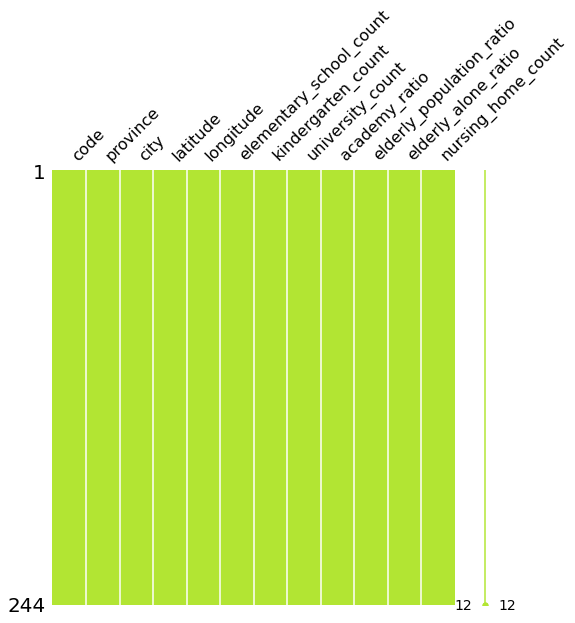

In [15]:
# Plotting null data of region data

msno.matrix(df=region.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [16]:
# Which features are numeric ?

cols = region.columns
num_cols = region._get_numeric_data().columns
num_cols

Index(['code', 'latitude', 'longitude', 'elementary_school_count',
       'kindergarten_count', 'university_count', 'academy_ratio',
       'elderly_population_ratio', 'elderly_alone_ratio',
       'nursing_home_count'],
      dtype='object')

In [17]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

['city', 'province']

In [18]:
# Time data cleaning

for col in time.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (time[col].isnull().sum() / time[col].shape[0]))
    print(msg)

column:       date	 Percent of NaN value: 0.00%
column:       time	 Percent of NaN value: 0.00%
column:       test	 Percent of NaN value: 0.00%
column:   negative	 Percent of NaN value: 0.00%
column:  confirmed	 Percent of NaN value: 0.00%
column:   released	 Percent of NaN value: 0.00%
column:   deceased	 Percent of NaN value: 0.00%


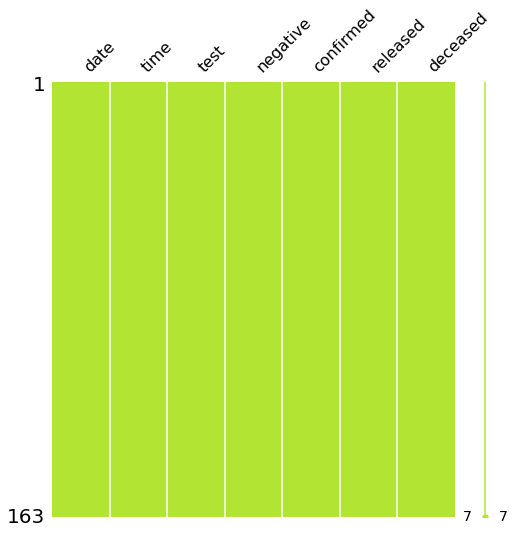

In [19]:
# Plotting null data of time data

msno.matrix(df=time.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [20]:
# Which features are numeric ?

cols = time.columns
num_cols = time._get_numeric_data().columns
num_cols

Index(['time', 'test', 'negative', 'confirmed', 'released', 'deceased'], dtype='object')

In [21]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

['date']

In [22]:
# Time Age data cleaning

for col in time_age.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (time_age[col].isnull().sum() / time_age[col].shape[0]))
    print(msg)

column:       date	 Percent of NaN value: 0.00%
column:       time	 Percent of NaN value: 0.00%
column:        age	 Percent of NaN value: 0.00%
column:  confirmed	 Percent of NaN value: 0.00%
column:   deceased	 Percent of NaN value: 0.00%


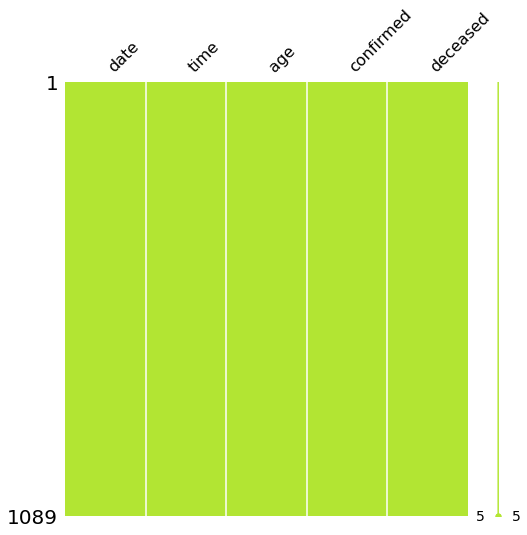

In [23]:
# Plotting null data of Time Age data

msno.matrix(df=time_age.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [24]:
# Which features are numeric ?

cols = time_age.columns
num_cols = time_age._get_numeric_data().columns
num_cols

Index(['time', 'confirmed', 'deceased'], dtype='object')

In [25]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

['age', 'date']

In [26]:
# Time Gender data cleaning

for col in time_gender.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (time_gender[col].isnull().sum() / time_gender[col].shape[0]))
    print(msg)

column:       date	 Percent of NaN value: 0.00%
column:       time	 Percent of NaN value: 0.00%
column:        sex	 Percent of NaN value: 0.00%
column:  confirmed	 Percent of NaN value: 0.00%
column:   deceased	 Percent of NaN value: 0.00%


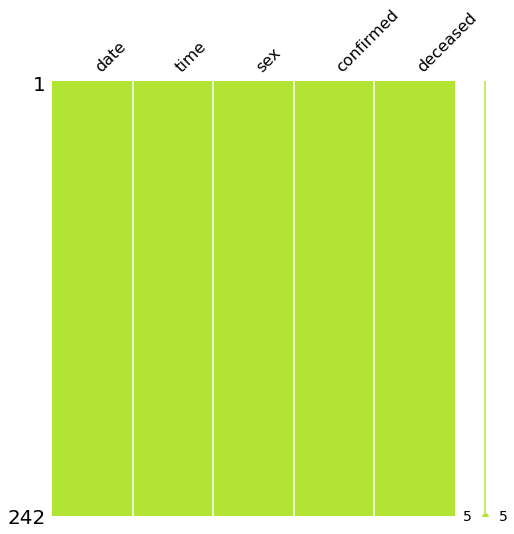

In [27]:
# Plotting null data of Time Gender data

msno.matrix(df=time_gender.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [28]:
# Which features are numeric ?

cols = time_gender.columns
num_cols = time_gender._get_numeric_data().columns
num_cols

Index(['time', 'confirmed', 'deceased'], dtype='object')

In [29]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

['sex', 'date']

In [30]:
# Time Province data cleaning

for col in time_province.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (time_province[col].isnull().sum() / time_province[col].shape[0]))
    print(msg)

column:       date	 Percent of NaN value: 0.00%
column:       time	 Percent of NaN value: 0.00%
column:   province	 Percent of NaN value: 0.00%
column:  confirmed	 Percent of NaN value: 0.00%
column:   released	 Percent of NaN value: 0.00%
column:   deceased	 Percent of NaN value: 0.00%


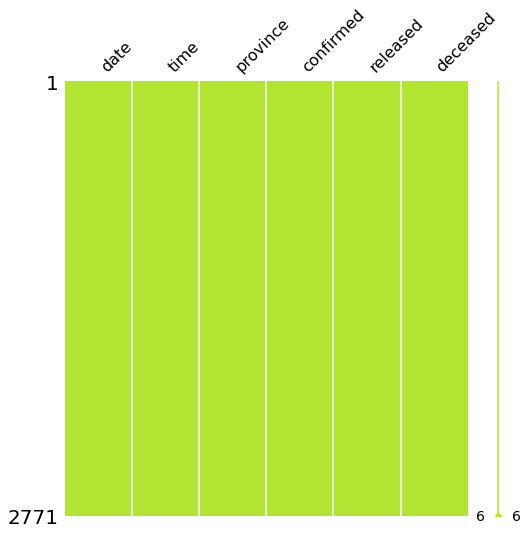

In [31]:
# Plotting null data of time province data

msno.matrix(df=time_province.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [32]:
# Which features are numeric ?

cols = time_province.columns
num_cols = time_province._get_numeric_data().columns
num_cols

Index(['time', 'confirmed', 'released', 'deceased'], dtype='object')

In [33]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

['province', 'date']

In [35]:
# Weather data cleaning

for col in weather.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (weather[col].isnull().sum() / weather[col].shape[0]))
    print(msg)

column:       code	 Percent of NaN value: 0.00%
column:   province	 Percent of NaN value: 0.00%
column:       date	 Percent of NaN value: 0.00%
column:   avg_temp	 Percent of NaN value: 0.06%
column:   min_temp	 Percent of NaN value: 0.02%
column:   max_temp	 Percent of NaN value: 0.01%
column: precipitation	 Percent of NaN value: 0.00%
column: max_wind_speed	 Percent of NaN value: 0.03%
column: most_wind_direction	 Percent of NaN value: 0.11%
column: avg_relative_humidity	 Percent of NaN value: 0.08%


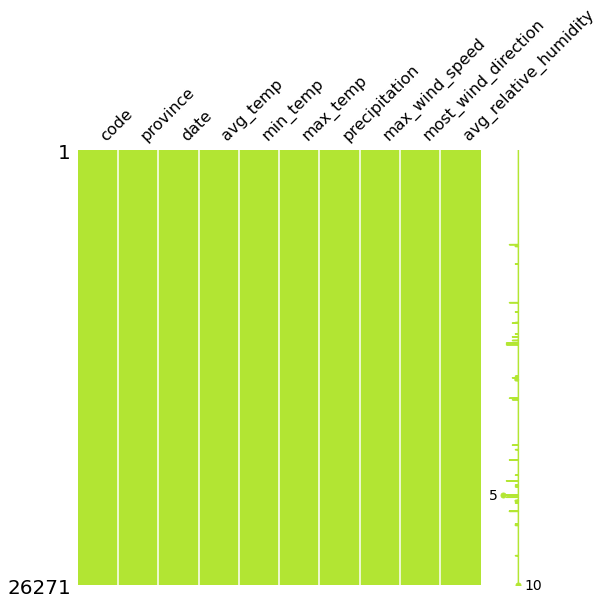

In [36]:
# Plotting null data of weather data

msno.matrix(df=weather.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [34]:
# Which features are numeric ?

cols = weather.columns
num_cols = weather._get_numeric_data().columns
num_cols

Index(['code', 'avg_temp', 'min_temp', 'max_temp', 'precipitation',
       'max_wind_speed', 'most_wind_direction', 'avg_relative_humidity'],
      dtype='object')

In [35]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

['province', 'date']

Using the patient information dataset (patient_info), I will analyse how different demographic features potentially contribute to the death of COVID-19 patients in South Korea.

In [46]:
# Checking null data of patient_info data

for col in patient_info.columns:
    msg = 'column: {:>10}\t Percent of NaN value: {:.2f}%'.format(col, 100 * (patient_info[col].isnull().sum() / patient_info[col].shape[0]))
    print(msg)

column: patient_id	 Percent of NaN value: 0.00%
column:        sex	 Percent of NaN value: 21.72%
column:        age	 Percent of NaN value: 26.72%
column:    country	 Percent of NaN value: 0.00%
column:   province	 Percent of NaN value: 0.00%
column:       city	 Percent of NaN value: 1.82%
column: infection_case	 Percent of NaN value: 17.79%
column: infected_by	 Percent of NaN value: 73.94%
column: contact_number	 Percent of NaN value: 84.69%
column: symptom_onset_date	 Percent of NaN value: 86.64%
column: confirmed_date	 Percent of NaN value: 0.06%
column: released_date	 Percent of NaN value: 69.27%
column: deceased_date	 Percent of NaN value: 98.72%
column:      state	 Percent of NaN value: 0.00%


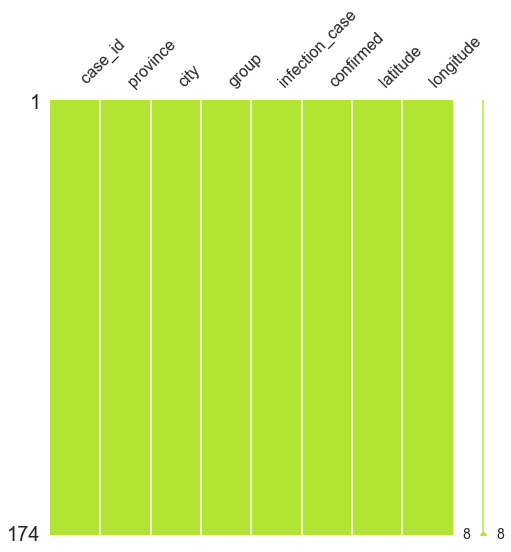

In [47]:
# Plotting null data of patient_info data

msno.matrix(df=p_info.iloc[:, :], figsize=(8,8), color=(0.7,0.9,0.2));

In [48]:
# Which features are numeric ?

cols = patient_info.columns
num_cols = patient_info._get_numeric_data().columns
num_cols

Index(['patient_id'], dtype='object')

In [49]:
# Which are categorical?

cat_cols = list(set(cols) - set(num_cols))
cat_cols

['infection_case',
 'infected_by',
 'sex',
 'state',
 'country',
 'city',
 'released_date',
 'deceased_date',
 'contact_number',
 'age',
 'confirmed_date',
 'province',
 'symptom_onset_date']

## Observations

<p> From case, region and various time datasets there are no information missing while in the weather data set there are a bit but they are miniscule when it will come to analysing data. </p>
<p> However for patient_info data there are quite a bit of data missing. Highest percentage of data not present in features such as deceased_date (98.72%), symptom_onset_date (86.64%), contact_number (84.69%), infected_by (73.94%) and released_date (69.27%). That being said, presence of patients with infection_case data implies they had no underlying disease. I will just fill the null data with 'False'. Similarly for deceased_date, it just implies that patients with missing deceased_date are discharged or isolated.

However, with so many missing data on features like symptom_onset_date, I may choose to ignore the features for the analysis.

Notably there are patients with sex, age and city data all missing.

Overall, the analysis may be limited due to the large presence of missing data. </p>

## Treating the outliers
 In the below sections we are treating the outliers. The dots in the graphs below show the outliers.

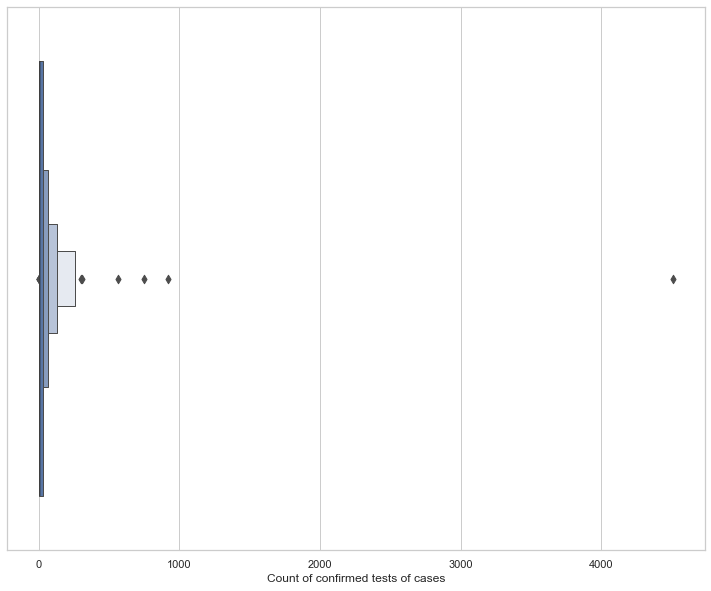

In [50]:
# Setting the dimensions and overwriting the default background value

sns.set(rc={'figure.figsize':(12.5,10.0)})
sns.set_theme(style="whitegrid")

# Selecting boxenplot for visualization and setting x label 

sns.boxenplot(x=case['confirmed']);
plt.xlabel('Count of confirmed tests of cases');

# Expected result: outlier identifications between 0 and above 4000

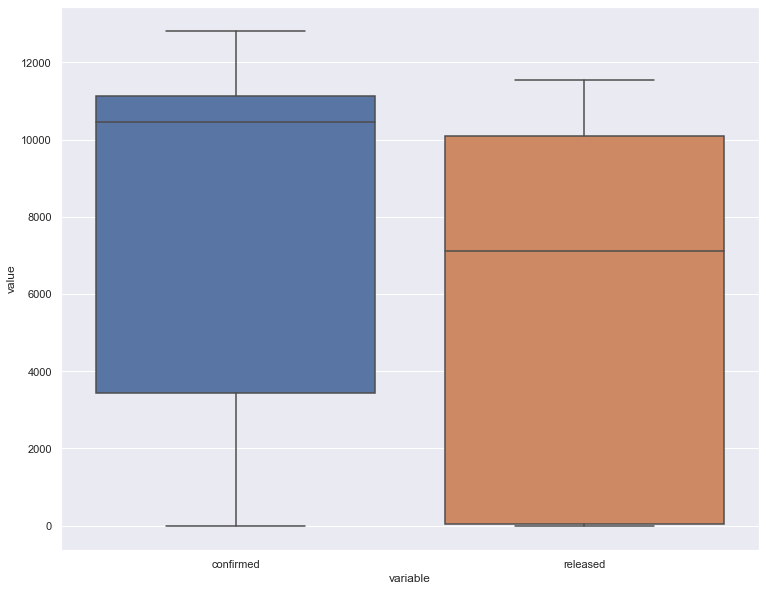

In [51]:
# Assigning a new dataframe (df) 2 features ranging from 0 to above 12000

df = pd.DataFrame(data = time, columns = ['confirmed', 'released'])

# Setting the dimensions and overwriting the default values

sns.set(rc={'figure.figsize':(12.5,10.0)})

# Selecting boxplot for visualization 

sns.boxplot(x="variable", y="value", data=pd.melt(df))

# Plotting outliers within 2 features ranging from 0 to above 12000 

plt.show()

# Expected result: outlier identifications

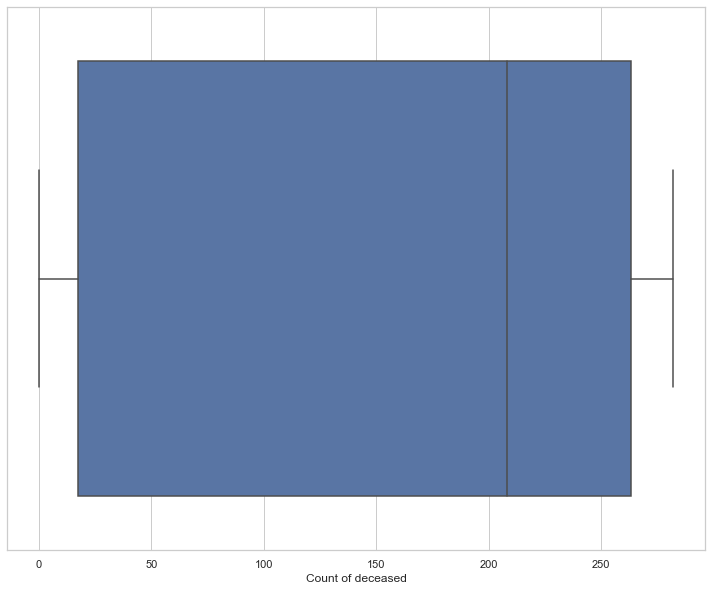

In [52]:
# Setting the dimensions and overwriting the default background value

sns.set(rc={'figure.figsize':(12.5,10.0)})
sns.set_theme(style="whitegrid")

# Selecting boxplot for visualization of deceased count in time data and setting x label 

sns.boxplot(x=time['deceased']);
plt.xlabel('Count of deceased');

# Expected result: outlier identifications between 0 and over 250

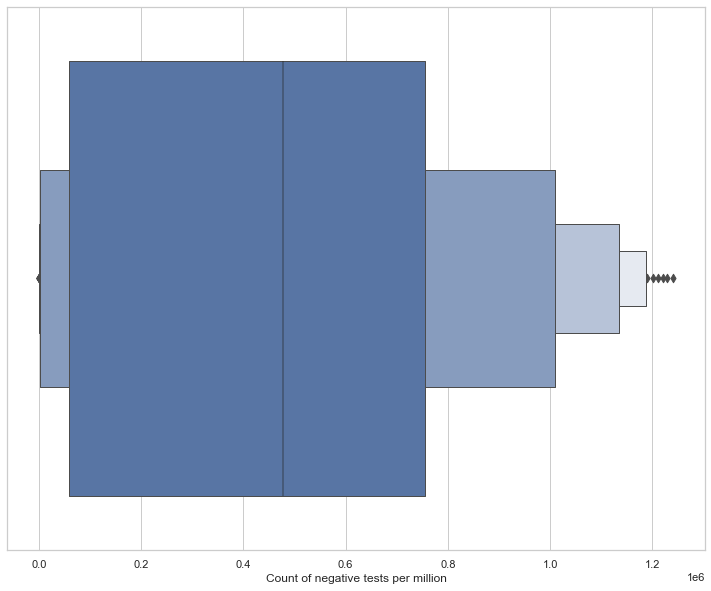

In [53]:
# Setting the dimensions and overwriting the default background value

sns.set(rc={'figure.figsize':(12.5,10.0)})
sns.set_theme(style="whitegrid")

# Selecting boxenplot for visualing negative counts of time data and setting x label 

sns.boxenplot(x=time['negative']);
plt.xlabel('Count of negative tests per million');

# Expected result: outlier identifications between 0 and 1.2 million

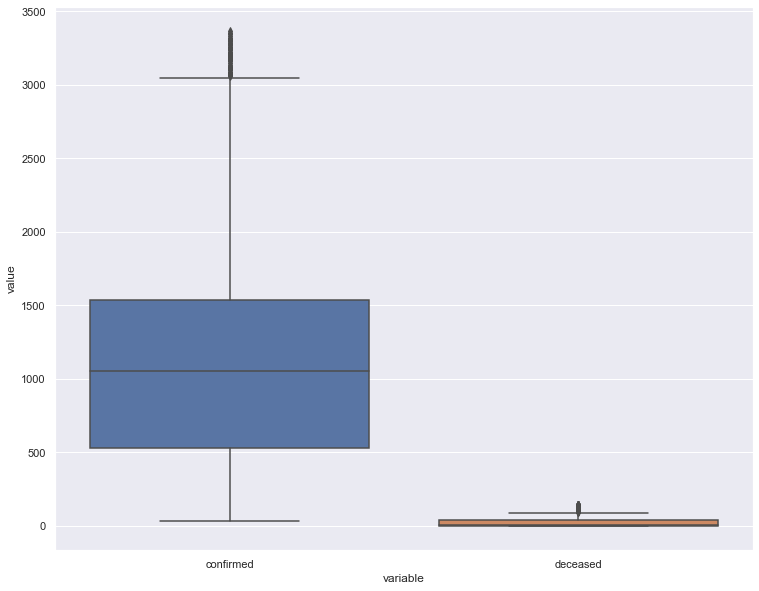

In [172]:
# Assigning a new dataframe (df) from a time_age data 2 features ranging from 0 to 3500
df = pd.DataFrame(data = time_age, columns = ['confirmed', 'deceased'])

# Setting the dimensions and overwriting the default values

sns.set(rc={'figure.figsize':(12.5,10.0)})

# Selecting boxplot for visualization 

sns.boxplot(x="variable", y="value", data=pd.melt(df))

# Plotting outliers within 2 features ranging from 0 to 3500 

plt.show()

# Expected result: outlier identifications

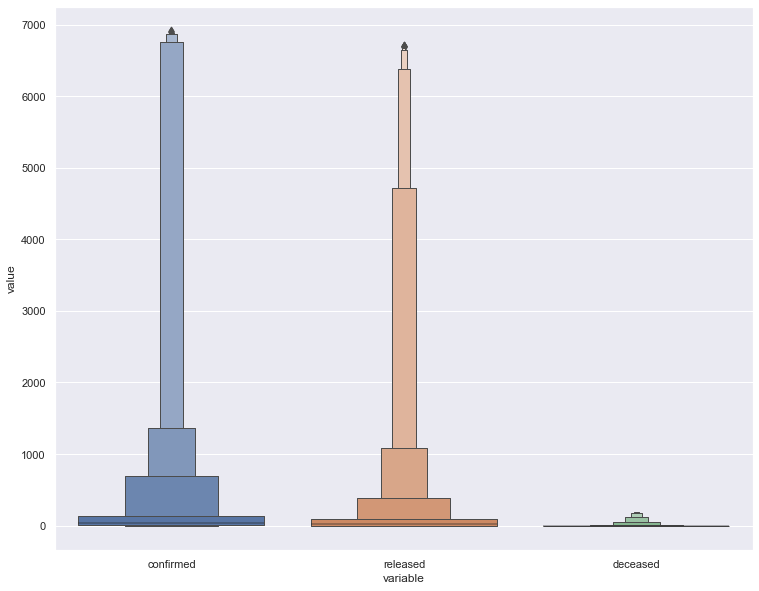

In [55]:
# Assigning a new dataframe (df) with 3 features ranging from 0 to 7000

df = pd.DataFrame(data = time_province, columns = ['confirmed', 'released', 'deceased'])

# Setting the dimensions and overwriting the default values

sns.set(rc={'figure.figsize':(12.5,10.0)})

# Selecting boxplot for visualization 

sns.boxenplot(x="variable", y="value", data=pd.melt(df))

# Plotting outliers within 4 features ranging from 0 to 7000

plt.show()

# Expected result: outlier identifications

# Exploratory Data Analysis

## Which patient populations pass away from COVID-19?

Using the DS4C dataset, specifically the patient information dataset (patient_info), I will analyse how different demographic features potentially contribute to the death of COVID-19 patients in South Korea.

Potential areas of analysis: Analysing if the difference in the time between the confirmed date and the released/deceased date is significant between recovered/deceased patients.

Analysing the dataset only based on the released and deceased dataset, excluding the isolated patients since their outcome is unknown.

### Checking the target label of state

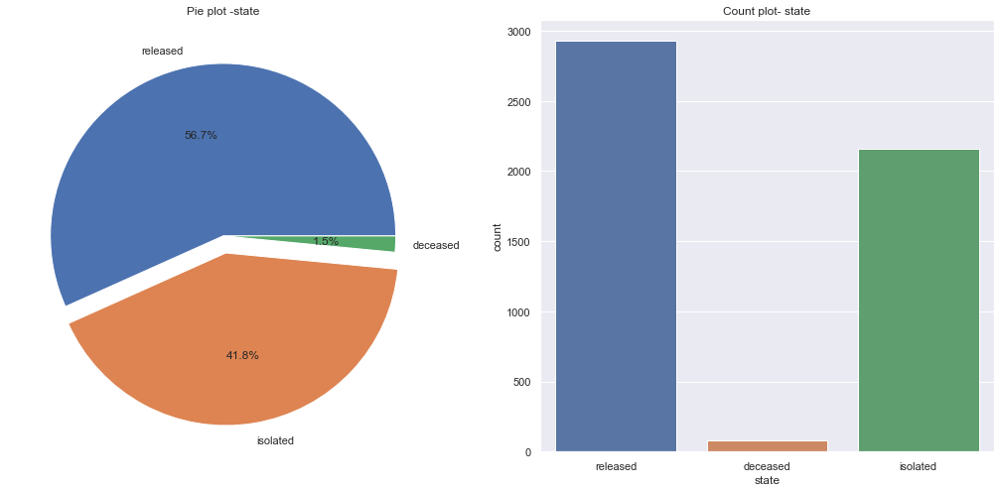

In [59]:
f, ax = plt.subplots(1,2, figsize=(18,8))
patient_info['state'].value_counts().plot.pie(explode=[0, 0.1,0], autopct='%1.1f%%', ax=ax[0], shadow=False)
ax[0].set_title('Pie plot -state')
ax[0].set_ylabel('')
sns.countplot('state', data=patient_info, ax=ax[1])
ax[1].set_title("Count plot- state")

plt.show()

### Observation:

Only 1.5% of the patient population has deceased. The distribution of target label (released/deceased/isolated) is unbalanced.

## Feature analysis 

### Age

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


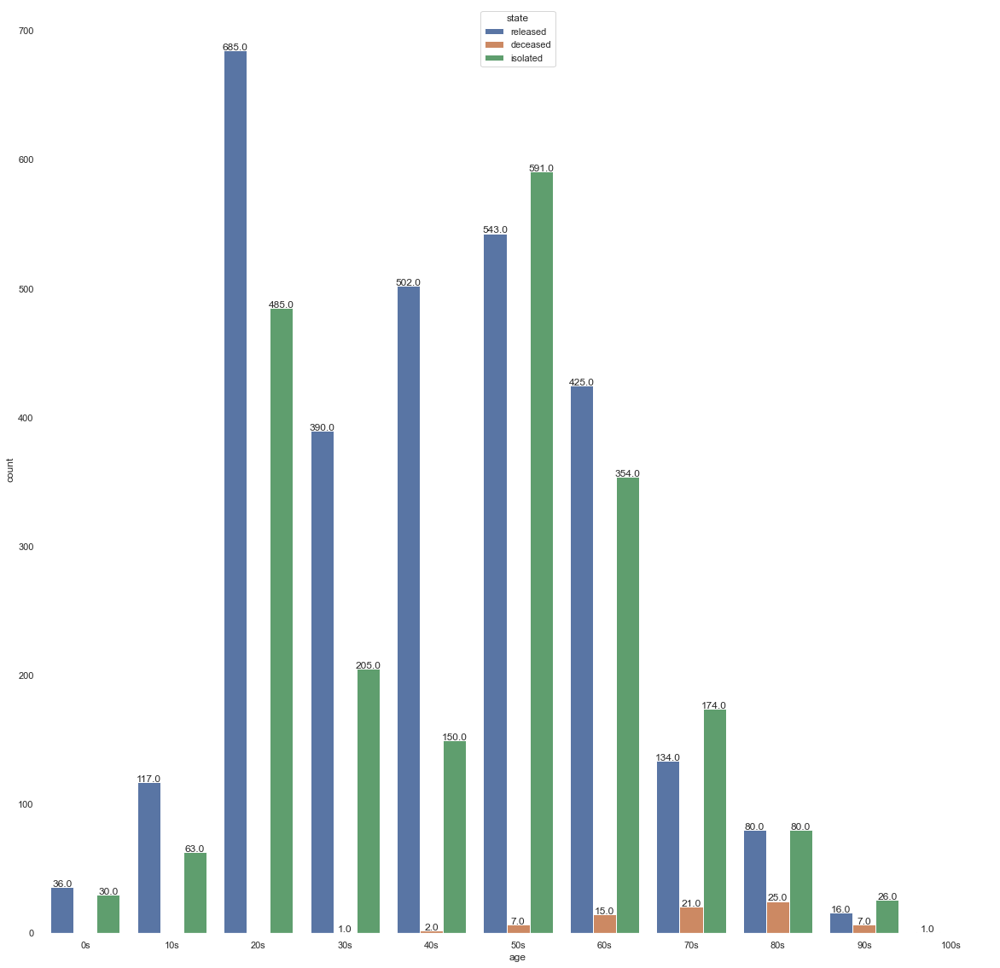

In [64]:
patient_info = patient_info.fillna(method = 'ffill')
order = ['0s','10s','20s','30s','40s','50s','60s','70s','80s','90s','100s']
figure(figsize=(20,20))
plt.rcParams['axes.facecolor'] = 'white'
graph= sns.countplot('age', hue='state', data = patient_info, order=order)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")
show();

In [68]:
print('Mortality rate within the age groups')
print('Mortality rate of 30s: {:.2f}%'.format(1*100/(1+169+282)))
print('Mortality rate of 40s: {:.2f}%'.format(2*100/(2+150+308)))
print('Mortality rate of 50s: {:.2f}%'.format(7*100/(7+375+218)))
print('Mortality rate of 60s: {:.2f}%'.format(12*100/(12+190+203)))
print('Mortality rate of 70s: {:.2f}%'.format(19*100/(19+81+104)))
print('Mortality rate of 80s: {:.2f}%'.format(23*100/(23+84+49)))
print('Mortality rate of 90s: {:.2f}%'.format(7*100/(7+13+25)))

Mortality rate within the age groups
Mortality rate of 30s: 0.22%
Mortality rate of 40s: 0.43%
Mortality rate of 50s: 1.17%
Mortality rate of 60s: 2.96%
Mortality rate of 70s: 9.31%
Mortality rate of 80s: 14.74%
Mortality rate of 90s: 15.56%


**Observations:**

**1)** In the age groups of 30s to 80s, the absolute number of deaths increased as the age group increased. There is overall trend of increase in death of 0s to 90s.

**2)** The mortality rate within the age group increased as the age increases. There were no death from patients in 0s to 20s age group. While there is also no deaths from 100s age group, there is only 1 patient that belong to that group. Hence the mortality rate in 100s may be inaccurate.

**3)** We can infer from the above observations that as the patient's age group increases, there is higher chance of the patient passing away from COVID-19

### Affected by Sex

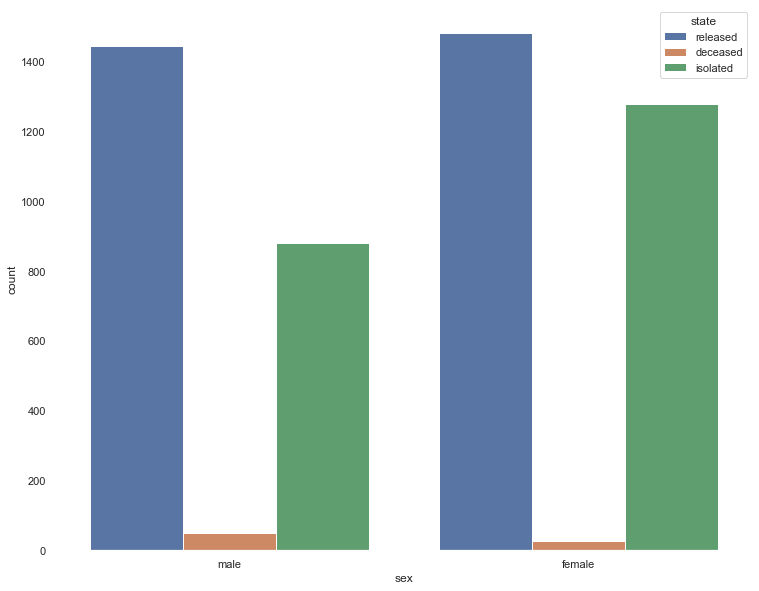

In [69]:
patient_info['sex'].fillna('NaN', inplace=True)
sns.countplot('sex', hue='state', data = patient_info)
ax[1].set_title('Sex: State')
plt.show;

In [72]:
# Table summary of sexes with all counts

pd.crosstab(patient_info['sex'], patient_info['state'], margins = True).style.background_gradient(cmap='summer_r')

state,deceased,isolated,released,All
sex,,,,
female,28,1278,1483,2789
male,50,880,1446,2376
All,78,2158,2929,5165


In [73]:
# Printing mortality by sexes

print('Mortality rate by sex')
print('Mortality rate of male: {:.2f}%'.format(50*100/(2376)))
print('Mortality rate of female: {:.2f}%'.format(28*100/(2789)))

Mortality rate by sex
Mortality rate of male: 2.10%
Mortality rate of female: 1.00%


**Observation:** Male mortality rate is much higher than female (2.10% vs 1.00%).


### Checking Province

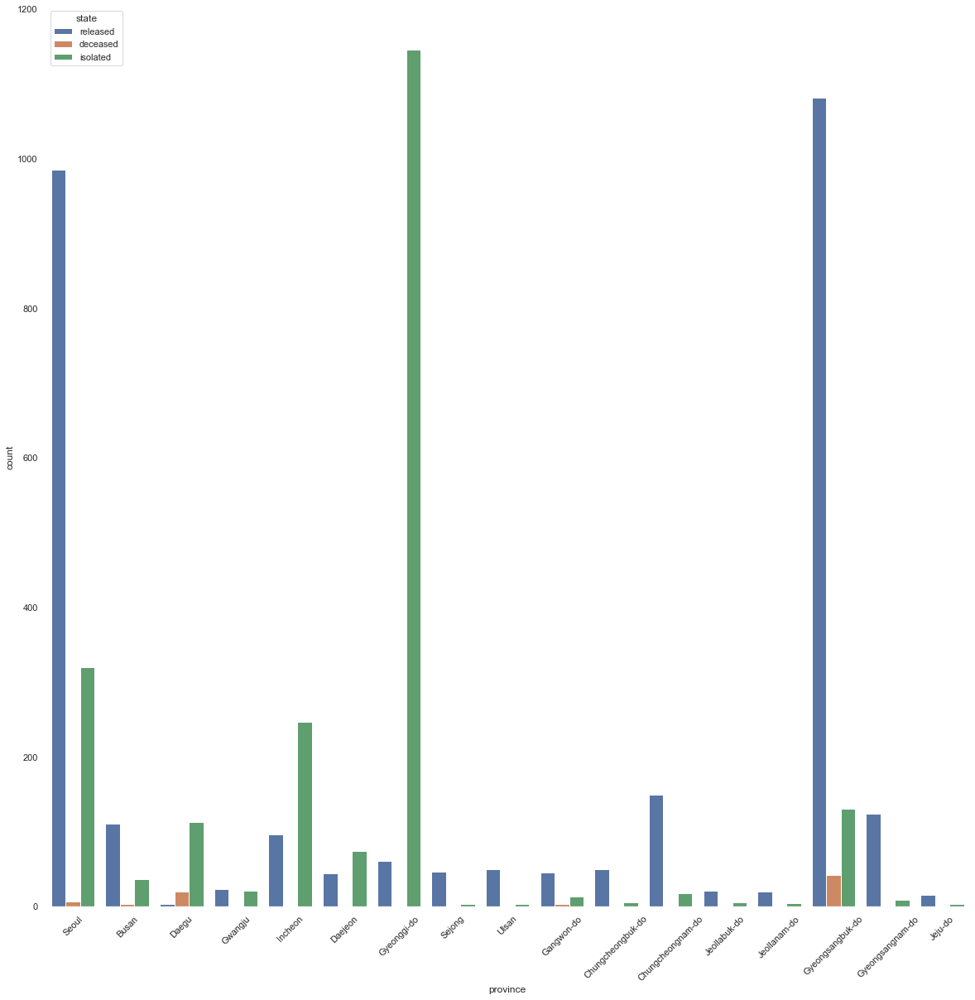

In [76]:
figure(figsize=(20,20))
graph= sns.countplot('province', hue='state', data = patient_info)
ax[1].set_title('Province: State')
graph.set_xticklabels(graph.get_xticklabels(), rotation=45)
plt.show;

In [78]:
# Table summary of provinces with all counts

pd.crosstab(patient_info['province'], patient_info['state'], margins = True).style.background_gradient(cmap='summer_r')

state,deceased,isolated,released,All
province,,,,
Busan,3,37,111,151
Chungcheongbuk-do,0,6,50,56
Chungcheongnam-do,0,18,150,168
Daegu,20,113,4,137
Daejeon,1,74,44,119
Gangwon-do,3,14,46,63
Gwangju,0,21,23,44
Gyeonggi-do,1,1146,61,1208
Gyeongsangbuk-do,42,131,1081,1254


In [81]:
# Printing mortality by provinces

print('Mortality rate by provinces')
print('Mortality rate of patients from Busan: {:.2f}%'.format(3*100/(151)))
print('Mortality rate of patients from Daegu: {:.2f}%'.format(20*100/(137)))
print('Mortality rate of patients from Daejeon: {:.2f}%'.format(1*100/(119)))
print('Mortality rate of patients from Gangwon-do: {:.2f}%'.format(3*100/(63)))
print('Mortality rate of patients from Gyeonggi-do: {:.2f}%'.format(1*100/(1208)))
print('Mortality rate of patients from Gyeongsangbuk-do: {:.2f}%'.format(42*100/(1254)))
print('Mortality rate of patients from Seoul: {:.2f}%'.format(7*100/(1312)))
print('Mortality rate of patients from Ulsan: {:.2f}%'.format(1*100/(55)))

Mortality rate by provinces
Mortality rate of patients from Busan: 1.99%
Mortality rate of patients from Daegu: 14.60%
Mortality rate of patients from Daejeon: 0.84%
Mortality rate of patients from Gangwon-do: 4.76%
Mortality rate of patients from Gyeonggi-do: 0.08%
Mortality rate of patients from Gyeongsangbuk-do: 3.35%
Mortality rate of patients from Seoul: 0.53%
Mortality rate of patients from Ulsan: 1.82%


**Observation** Daegu had the highest mortality rate with 14.60%. Ganwon-do, Gyeongsangbuk-do, Busan and Ulsan are followed by with 4.76% 3.35%, 1.99% and 1.82% respectively as the rest of the provinces have low or zero mortality rate.

In [82]:
# #1
# # read in data (provided via course website)
# data_dir = '/Users/Aurimas/Documents/Python/TC_projects/Covid-19'
# case = pd.read_csv(os.path.join(data_dir, 'Case.csv'), na_values='-')
# # patient_route = pd.read_csv(os.path.join(data_dir, 'PatientRoute.csv'))
# region = pd.read_csv(os.path.join(data_dir, 'Region.csv'))

# # Subsampling patient route to improve map visualization performance
# # patient_route = patient_route.sample(750, random_state=1)

In [91]:
# case.info()
case["latitude"] = pd.to_numeric(case.latitude, errors='coerce')
case["longitude"] = pd.to_numeric(case.latitude, errors='coerce')

In [92]:
case.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174 entries, 0 to 173
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0    case_id        174 non-null    int64  
 1   province        174 non-null    object 
 2   city            174 non-null    object 
 3   group           174 non-null    bool   
 4   infection_case  174 non-null    object 
 5   confirmed       174 non-null    int64  
 6   latitude        65 non-null     float64
 7   longitude       65 non-null     float64
dtypes: bool(1), float64(2), int64(2), object(3)
memory usage: 9.8+ KB


## How Covid-19 spread around South Korea?

In [93]:
# Grouping confirmed cases by province only
case_province = pd.DataFrame(case['confirmed'].groupby(case['province']).sum())

# get average geocode info
gc = case[['latitude', 'longitude']].groupby(case['province']).mean()

# Gettinh average geocode info from Region dataset that is more complete
gc = region[['latitude', 'longitude']].groupby(region['province']).mean()

# combine into single dataset
df_case = case_province.join(gc)

# center of lon & lat average
center = df_case.mean()

In [94]:
# Generating map object for cases
fig = px.scatter_mapbox(df_case,
                        lat='latitude', lon='longitude', 
                        size='confirmed', size_max=50,
                        hover_name=df_case.index)

# Updating layout
fig.update_layout(mapbox_style= "carto-positron", 
                  mapbox_zoom=6, 
                  mapbox_center_lat = center['latitude'],
                  mapbox_center_lon = center['longitude'],
                  
                  margin={"r":0,"t":0,"l":0,"b":0})

fig.show();

In [95]:
# Making new assignments of region data

region_counts = region[['nursing_home_count','kindergarten_count', 'elementary_school_count','university_count']]
region_counts = region_counts.groupby(region['province']).sum()
region_counts = region_counts.join(gc)
region_counts['province'] = region_counts.index
region_melt = pd.melt(region_counts, id_vars=['province', 'latitude', 'longitude'])

In [102]:
# Plotting a scatter plot with specific spread locations

fig = px.scatter_mapbox(region_melt, 
                        lat='latitude', lon='longitude',
                        color='variable', opacity=0.3,
                        size='value', size_max=50)

fig.update_layout(mapbox_style= "carto-positron", 
                  mapbox_zoom=6, 
                  mapbox_center_lat = center['latitude'],
                  mapbox_center_lon = center['longitude'],
                  margin={"r":0,"t":0,"l":0,"b":0})

fig.show();


In [130]:
# Making new assignments

time_cumulative = time[['test', 'confirmed']].cumsum()
time_cumulative['date'] = time['date']
time_cumulative_melt = pd.melt(time_cumulative, id_vars=['date'])

In [145]:
# Plotting three graphs

fig = px.bar(time, x = 'date', y = 'confirmed', labels={'date':'Date', 'confirmed': 'Count of confirmed'})
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Confirmed cases per day', title_x=0.5)
fig.show()

fig = px.line(time_cumulative, x = 'date', y = 'confirmed', labels={'date':'Date', 'confirmed': 'Count of confirmed'})
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Total confirmed cases', title_x=0.5)
fig.show()

time_cumulative['confirmed_ratio'] = time_cumulative['confirmed'] / time_cumulative['test']
fig = px.line(time_cumulative, x = 'date', y = 'confirmed_ratio', labels={'confirmed_ratio':'Ratio of confirmed test cases', 'date': 'Date'})
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Ratio of confirmed cases versus total cases', title_x=0.5)
fig.show()

In [146]:
# Grouping, joining and assigning confirmed and deceased cases by age

time_age_cumulative = time_age[['confirmed', 'deceased']].groupby(time_age['age']).cumsum()
time_age_cumulative = time_age[['date', 'age']].join(time_age_cumulative)
time_age_cumulative_melt = pd.melt(time_age_cumulative, id_vars=['date', 'age'])

In [150]:
# Plotting a line graphs per age groups

fig = px.line(time_age_cumulative_melt, x = 'date', y = 'value', color = 'variable', 
              labels={'date':'Date', 'value': 'Count of cases', 'age': 'Age'},
              facet_col='age', facet_col_wrap=5)
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',})
fig.show()

In [151]:
# Grouping, joining and assigning confirmed and deceased cases by sex


time_gender_cumulative = time_gender[['confirmed', 'deceased']].groupby(time_gender['sex']).cumsum()
time_gender_cumulative = time_gender[['date', 'sex']].join(time_gender_cumulative)
time_gender_cumulative_melt = pd.melt(time_gender_cumulative, id_vars=['date', 'sex'])

In [158]:
# Plotting a line graphs per sexes


fig = px.line(time_gender_cumulative_melt, 
              x = 'date', y = 'value', 
              labels={'date':'Date', 'value': 'Count of variable cases', 'sex': 'Sex'},
              color = 'sex', facet_row='variable')
fig.update_yaxes(matches=None)
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Variable cases', title_x=0.5)
fig.show()

# How various diseases fluctuate with coronavirus

In [161]:
# Describing search data set statistics

search.describe()

,cold,flu,pneumonia,coronavirus
count,1642.000000,1642.000000,1642.000000,1642.000000
mean,0.190506,0.244946,0.221430,1.862522
std,0.459556,0.762229,0.463014,9.042341
min,0.051630,0.009810,0.068810,0.001540
25%,0.106630,0.042105,0.128630,0.006270
50%,0.133170,0.097855,0.164445,0.008900
75%,0.165900,0.250035,0.209765,0.013158
max,15.720710,27.327270,11.393200,100.000000


In [162]:
# Measuring the asymmetry of the probability distribution within search data set

search.skew()

cold           25.039360
flu            27.830114
pneumonia      15.397069
coronavirus     6.584506
dtype: float64

In [163]:
# Findinh the kurtosis over the diseases

search.kurt()

cold           805.815285
flu            973.393024
pneumonia      302.186384
coronavirus     47.697505
dtype: float64

In [168]:
search_melt = pd.melt(search)

In [169]:
search_melt.head()

,variable,value
0,cold,0.11663
1,cold,0.13372
2,cold,0.14917
3,cold,0.17463
4,cold,0.17226


In [170]:
# Plotting box plot to see the values of various diseases with respect to coronavirus

fig = px.box(search_melt, y = 'value', color = 'variable', 
             labels={'value': 'Counts of variable (disease) cases'},log_y=True)
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Variable cases', title_x=0.5)
fig.show()

In [173]:
fig = px.scatter_matrix(search)
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Variable cases', title_x=0.5)
fig.show()


**Observation:** Based on the statistics, and boxplots, each of the terms looks to have a pretty wide distribution. From the scatter plot matrix, the data seems to be pretty random, there does not seem to be an obvious relationship (e.g. linear).

In [174]:
# Investigating weather data

# print(weather)

weather.index = weather['date']
weather = weather.drop('date', axis=1)
temp = weather[['avg_temp', 'min_temp', 'max_temp']]
precip = weather[['precipitation', 'avg_relative_humidity']]
wind = weather[['max_wind_speed', 'most_wind_direction']]

search.index = SearchTrend['date']
print(search.index)

Index(['2016-01-01', '2016-01-02', '2016-01-03', '2016-01-04', '2016-01-05',
       '2016-01-06', '2016-01-07', '2016-01-08', '2016-01-09', '2016-01-10',
       ...
       '2020-06-20', '2020-06-21', '2020-06-22', '2020-06-23', '2020-06-24',
       '2020-06-25', '2020-06-26', '2020-06-27', '2020-06-28', '2020-06-29'],
      dtype='object', name='date', length=1642)


In [179]:
# Plotting all four diseases how they change with temperatures

temp_trend = search.join(temp)
print(temp_trend)
temp_trend_melt = pd.melt(temp_trend, id_vars=['cold', 'flu', 'pneumonia', 'coronavirus'],
                          var_name = 'weather_var', value_name='weather_val')

temp_trend_melt2 = pd.melt(temp_trend_melt, id_vars = ['weather_var', 'weather_val'], 
                           var_name = 'search_var', value_name='search_val')

fig = px.scatter(temp_trend_melt2, x = 'weather_val', y = 'search_val', 
                 facet_col = 'weather_var', facet_row = 'search_var')
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Variable cases', title_x=0.5)
fig.update_yaxes(matches=None)
fig.show();

               cold      flu  pneumonia  coronavirus  avg_temp  min_temp  \
date                                                                       
2016-01-01  0.11663  0.05590    0.15726      0.00736       1.2      -3.3   
2016-01-01  0.11663  0.05590    0.15726      0.00736       5.3       1.1   
2016-01-01  0.11663  0.05590    0.15726      0.00736       1.7      -4.0   
2016-01-01  0.11663  0.05590    0.15726      0.00736       3.2      -1.5   
2016-01-01  0.11663  0.05590    0.15726      0.00736       3.1      -0.4   
...             ...      ...        ...          ...       ...       ...   
2020-06-29  0.14263  0.04308    0.11254      2.41501      22.0      19.7   
2020-06-29  0.14263  0.04308    0.11254      2.41501      21.9      20.0   
2020-06-29  0.14263  0.04308    0.11254      2.41501      20.4      17.4   
2020-06-29  0.14263  0.04308    0.11254      2.41501      21.9      18.8   
2020-06-29  0.14263  0.04308    0.11254      2.41501      23.2      19.1   

           

In [182]:
# Plotting all four diseases how they change with humidity


precip_trend = search.join(precip)

precip_trend_melt = pd.melt(precip_trend, id_vars = ['cold', 'flu', 'pneumonia', 'coronavirus'],
                           var_name = 'precip_var', value_name = 'precip_val')

precip_trend_melt2 = pd.melt(precip_trend_melt, id_vars = ['precip_var', 'precip_val'],
                            var_name = 'search_var', value_name = 'search_val')

fig = px.scatter(precip_trend_melt2, x = 'precip_val', y = 'search_val',
                facet_col = 'precip_var', facet_row = 'search_var')
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Variable cases', title_x=0.5)
fig.update_yaxes(matches=None)
fig.update_xaxes(matches=None)
fig.show()

In [183]:
# Plotting all four diseases how they change with wind

wind_search = search.join(wind)

wind_search_melt = pd.melt(wind_search, id_vars = ['cold', 'flu', 'pneumonia', 'coronavirus'],
                          var_name = 'wind_var', value_name = 'wind_val')

wind_search_melt2 = pd.melt(wind_search_melt, id_vars = ['wind_var', 'wind_val'],
                           var_name = 'search_var', value_name = 'search_val')

fig = px.scatter(wind_search_melt2, x = 'wind_val', y = 'search_val', 
                 facet_col = 'wind_var', facet_row = 'search_var')
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)',}, title_text='Variable cases', title_x=0.5)
fig.update_yaxes(matches=None)
fig.update_xaxes(matches=None)
fig.show()

In [184]:
#1

wind_search_melt2

,wind_var,wind_val,search_var,search_val
0,max_wind_speed,3.5,cold,0.11663
1,max_wind_speed,7.4,cold,0.11663
2,max_wind_speed,3.7,cold,0.11663
3,max_wind_speed,2.7,cold,0.11663
4,max_wind_speed,5.3,cold,0.11663
...,...,...,...,...
210163,most_wind_direction,90.0,coronavirus,2.41501
210164,most_wind_direction,90.0,coronavirus,2.41501
210165,most_wind_direction,160.0,coronavirus,2.41501
210166,most_wind_direction,160.0,coronavirus,2.41501


In [187]:
# Total confirmed cases in Korea
numConfirmedCases = case['confirmed'].sum();
display('Total confirmed cases: ', numConfirmedCases)

'Total confirmed cases: '

11395

In [186]:
#1

patient_info.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50s,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released


Identify trends by date and location tying in all 11 files

In [190]:
# Model 1: Perform SVM on data

patient_info['province_cat_codes'] = patient_info.province.astype('category').cat.codes
patient_info['city_cat_codes'] = patient_info.city.astype('category').cat.codes
patient_info['sex_cat_codes'] = patient_info.sex.astype('category').cat.codes
patient_info['age_cat_codes'] = patient_info.age.astype('category').cat.codes
patient_info['state_cat_codes'] = patient_info.state.astype('category').cat.codes

# Combine isolated and recovered patients into a single category to represent all living patients
patient_info.loc[(patient_info['state_cat_codes'] == 2) , 'state_cat_codes'] = 1

# There are way more trues than falses. So filter down
temp = patient_info.loc[patient_info['state_cat_codes'] == 1]

temp3 = patient_info.loc[patient_info['state_cat_codes'] == 0]

temp2 = temp.sample(n=len(temp3), random_state=1)

frames = [temp2, temp3]
balanced_patient_info = pd.concat(frames)
cor = balanced_patient_info.corr()
cor_target = abs(cor["state_cat_codes"])
relevant_features = cor_target[cor_target>0.5]

X = balanced_patient_info[['province_cat_codes','age_cat_codes']]
y = balanced_patient_info['state_cat_codes']
accuracies = list()
precisions = list()
recalls = list()
# Perform 2000 MC reps. There is no change after this to in the first two decimal places
for i in range(2000):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)
    y_train = y_train.astype(np.int8)

    clf = svm.SVC()
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)

    y_test = y_test.to_numpy()
    temp = np.vstack((y_test,y_pred)).transpose()

    accuracies.append(metrics.accuracy_score(y_test, y_pred))
    precisions.append(metrics.precision_score(y_test, y_pred))
    recalls.append(metrics.recall_score(y_test, y_pred))

print("Accuracy: ",mean(accuracies))
print("Precision: ",mean(precisions))
print("Recall: ",mean(recalls))


Accuracy:  0.7895769230769231
Precision:  0.8099070300216235
Recall:  0.7665815141500804


**Model 1 Analysis:** We can get a reasonable model by only using province, age, and disease.

**System flow:** generate categorical codes -> SVM -> metrics

**Runtime:** The runtime is O(n) due to the for-loop for the Monte Carlo reps. Depending on the number of Monte Carlo reps chosen, the runtime can vary drastically. This was definitely noticeable when increasing the number to 10000 reps or above


# Model 2: Is there a correlation between the number of places and individual has gone and how many people they infected?

### Which individuals affected the most other people?

In [56]:
infectors = patient_info.groupby('infected_by').count().reset_index()
infectors['num_patients_infected'] = infectors['patient_id']
patientCausesOfInfection = infectors[['infected_by','num_patients_infected']].sort_values(by=['num_patients_infected'],ascending=False)

# Top 3 culprits
print('Top 3 Infectors in Korea')
display(patientCausesOfInfection[0:3])

print('Bottom 3 Infectors in Korea (must have infected at least one person)')
display(patientCausesOfInfection[-1:-4:-1])

# Top culprit
topInfected_by = patientCausesOfInfection.head(1)
topInfected_by = topInfected_by['infected_by'].to_numpy()[0]

# Information about the top culprit
print('Top infector in Korea')
display(patient_info[patient_info['patient_id'] == topInfected_by])
print('')

# All patients affected by top culprit
print('All patients affected by top infector')
display(patient_info[patient_info['infected_by'] == topInfected_by])

Top 3 Infectors in Korea


,infected_by,num_patients_infected
340,2000000205,51
483,4100000008,27
335,2000000167,24


Bottom 3 Infectors in Korea (must have infected at least one person)


,infected_by,num_patients_infected
605,7000000009,1
238,1400000299,1
239,1400000301,1


Top infector in Korea


,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,province_cat_codes,city_cat_codes,sex_cat_codes,age_cat_codes,state_cat_codes



All patients affected by top infector


,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,province_cat_codes,city_cat_codes,sex_cat_codes,age_cat_codes,state_cat_codes
2429,2000000217,female,60s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,0,7,1
2430,2000000218,female,20s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,0,3,1
2431,2000000219,male,60s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,1,7,1
2432,2000000220,female,30s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,0,4,1
2433,2000000221,female,10s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,2,NaN,2020-03-15,NaN,NaN,isolated,7,127,0,2,1
2434,2000000222,female,50s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,0,6,1
2435,2000000223,male,50s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,1,6,1
2436,2000000224,male,30s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,1,4,1
2437,2000000225,male,50s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,1,6,1
2438,2000000226,female,50s,Korea,Gyeonggi-do,Seongnam-si,contact with patient,2000000205,NaN,NaN,2020-03-15,NaN,NaN,isolated,7,127,0,6,1


**Model 2 Analysis**

**System flow:** infector calculations -> input gathering -> dataframe -> filter

**Runtime:** This function has a runtime of O(*n*) due to the merging. Here is an article that references runtimes: https://wiki.python.org/moin/TimeComplexity.

It does not appear that going to lots of places necessarily indicates a large number of infections.

However, given a number of infections greater than or equal to 5, it certainly seems that as the number of places increased, so did the number of people an individual infected.

We only have routes for about 1/3 of patients we have info for, which is about 1/3 of the total cases in South Korea. So we are not able to include all data points.

Notice that that top infector (50+ people infected) is not included here because route information was not present.

Additionally, it is unclear whether a null value for infected means the individual infected 0 people or the value is simply unknown.

# Which cases had the biggest outbreak?


In [57]:
# Grouping infection cases

case_infection_case = case.groupby('infection_case').sum().reset_index()
confirmed_by_infection_case = case_infection_case[['infection_case','confirmed']].sort_values(by=['confirmed'],ascending=False)


# Top 5 culprits:

confirmed_by_infection_case['percentage_of_total'] = (confirmed_by_infection_case['confirmed'] / case['confirmed'].sum()) * 100
display(confirmed_by_infection_case[0:5])

,infection_case,confirmed,percentage_of_total
62,Shincheonji Church,5213,45.748135
76,contact with patient,1403,12.312418
77,etc,1192,10.460728
80,overseas inflow,949,8.328214
34,Itaewon Clubs,271,2.378236


The outbreak associated with Shincheonji Church is a huge issue. It accounts for over 50% of all cases in Korea! Not everyone from the church started in the same location, although most came from Daegu. This certainly explains why there are so many cases in Daegu. The media has blamed the church for the outbreak, as referenced below https://www.bbc.com/news/av/world-asia-51851250/shincheonji-and-coronavirus-the-mysterious-cult-church-blamed-for-s-korea-s-outbreak

# How many patients do we have data on and what is the largest infection case associated with this?



In [191]:
#1

# What percentage of patients do we have info for?
display('Percentage of patients we have info for: ', patient_info.shape[0] / numConfirmedCases * 100)

# Highest infection case type
patient_info_infection_case = patient_info.groupby('infection_case').count().reset_index()
patient_info_infection_case['num_patients'] = patient_info_infection_case['patient_id']
patientCausesOfInfection = patient_info_infection_case[['infection_case','num_patients']].sort_values(by=['num_patients'],ascending=False)
display(patientCausesOfInfection)

'Percentage of patients we have info for: '

45.326897762176394

,infection_case,num_patients
46,contact with patient,1610
50,overseas inflow,840
47,etc,703
21,Itaewon Clubs,162
30,Richway,128
17,Guro-gu Call Center,112
38,Shincheonji Church,107
5,Coupang Logistics Center,80
42,Yangcheon Table Tennis Club,44
8,Day Care Center,43



Interestingly enough, there is only data on 107 Shincheonji Church members. That is much less than the total number of cases associated. This suggests either lack of testing or potentially challenges getting the data.

# Who was the first infector in Korea?

In [192]:
# The first infector

display(patient_info.sort_values('confirmed_date').head(1))

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,province_cat_codes,city_cat_codes,sex_cat_codes,age_cat_codes,state_cat_codes
1644,1400000001,female,30s,China,Incheon,etc,overseas inflow,NaN,NaN,2020-01-19,2020-01-20,2020-02-06,NaN,released,10,161,0,4,1


The first infector appears to have come from Incheon in the Wuhan province of China and was an overseas transfer. This same individual was discussed on the media: https://www.who.int/csr/don/21-january-2020-novel-coronavirus-republic-of-korea-ex-china/en/

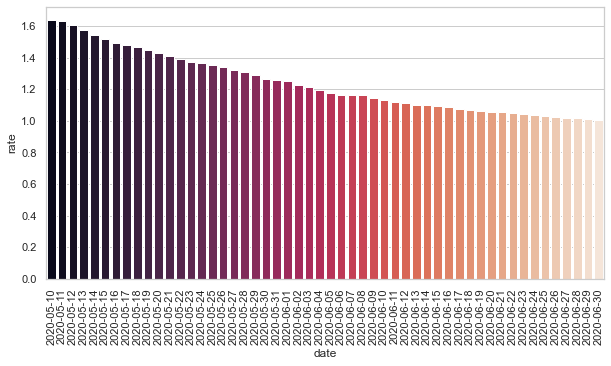

In [198]:
# Count of confirmed cases decrease

df_peroid         = time[time["date"] >= '2020-05-10'].copy()
df_peroid["rate"] = df_peroid["confirmed"]/df_peroid["test"] * 100 
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))
barplot = sns.barplot(x=df_peroid['date'], y=df_peroid['rate'], palette="rocket")
plt.rcParams['axes.facecolor'] = 'white'
plt.xticks(rotation=90)

plt.show()

The accumilated new cases are decreasing. It will be also interested to see what the trends of the daily new cases.

**NOTE**: Time_daily file is created

In [193]:
time_age.head(20)

,date,time,age,confirmed,deceased
0,2020-03-02,0,0s,32,0
1,2020-03-02,0,10s,169,0
2,2020-03-02,0,20s,1235,0
3,2020-03-02,0,30s,506,1
4,2020-03-02,0,40s,633,1
5,2020-03-02,0,50s,834,5
6,2020-03-02,0,60s,530,6
7,2020-03-02,0,70s,192,6
8,2020-03-02,0,80s,81,3
9,2020-03-03,0,0s,34,0


([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  62,
  63,
  64,
  65,
  66,
  67,
  68,
  69,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  77,
  78,
  79,
  80,
  81,
  82,
  83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  91,
  92,
  93,
  94,
  95,
  96,
  97,
  98,
  99,
  100,
  101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  113,
  114,
  115,
  116,
  117,
  118,
  119],
 [Text(0, 0, '2020-03-03'),
  Text(1, 0, '2020-03-04'),
  Text(2, 0, '2020-03-05'),
  Text(3, 0, '2020-03-06'),
  Text(4, 0, '2020-03-07'),
  Text(5, 0, '2020-03-08'),
  Text(6, 0, '2020-03-09'),
  Text(7, 0, '2020-03-10'),
  Text(8, 0, '2020-03-11'),
  Text(9, 0, '202

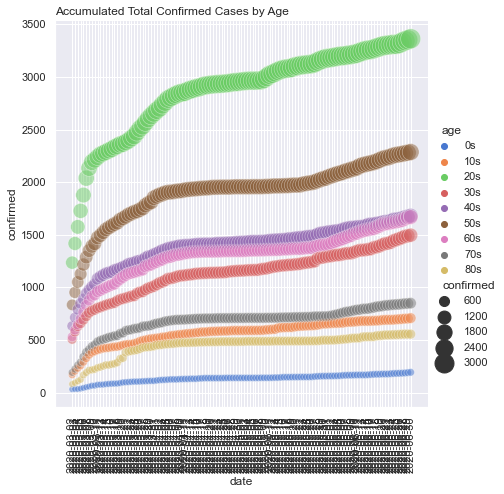

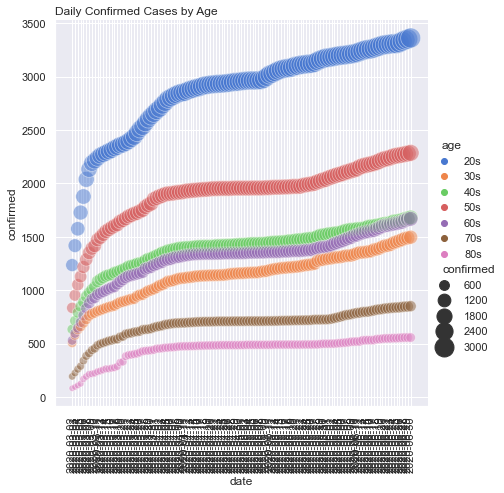

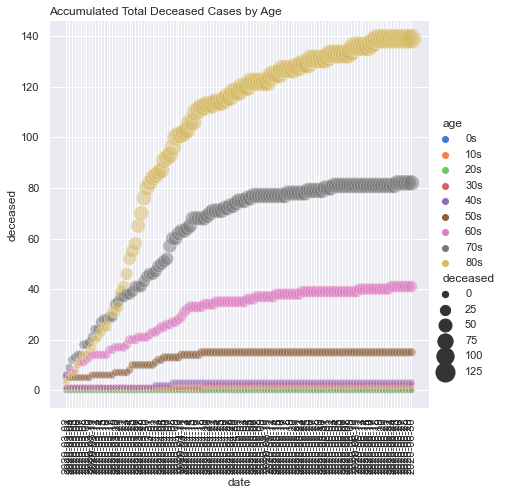

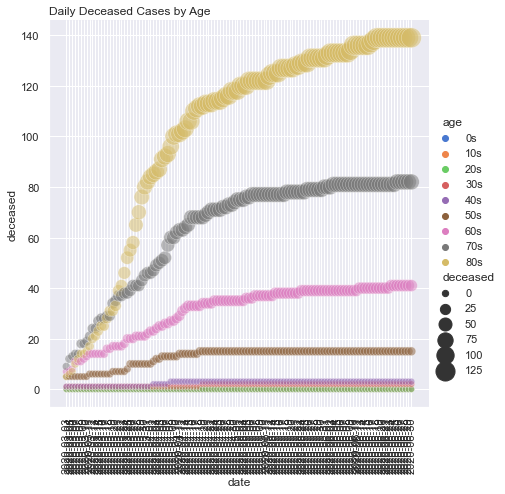

In [201]:
# Making a new assignment

df_daily_age  = time_age.copy()

r, d = df_daily_age.shape
for i in range(9, r):        # skip the first nine row
    for j in range(3,d) :   # skip the first three columns
        df_daily_age.iloc[i,j] = df_daily_age.iloc[i,j] - time_age.iloc[(i-9),j]
#     print(df_daily_age.iloc[i,:])

# Create TimeAge daily stats file
# file_name2='/kaggle/working/TimeAge_daily.csv'
# df_daily_age.to_csv(file_name2, sep=',', encoding='utf-8')

# Plot Accumulated Total Confirmed Cases by Age
sns.set(style="darkgrid")
sns.relplot(x="date", y="confirmed", hue="age", size="confirmed",
            sizes=(40, 400), alpha=.5, palette="muted",
            height=6, data=time_age)
plt.title('Accumulated Total Confirmed Cases by Age', loc = 'left', fontsize = 12)
plt.xticks(rotation=90)

# Plot Daily Confirmed Cases by Age
sns.set(style="darkgrid")
sns.relplot(x="date", y="confirmed", hue="age", size="confirmed",
            sizes=(40, 400), alpha=.5, palette="muted",
            height=6, data=time_age[time_age["age"] > '2020-03-02'])
plt.title('Daily Confirmed Cases by Age', loc = 'left', fontsize = 12)
plt.xticks(rotation=90)

# Plot Accumulated Total Deceased Cases by Age
sns.set(style="darkgrid")
sns.relplot(x="date", y="deceased", hue="age", size="deceased",
            sizes=(40, 400), alpha=.5, palette="muted",
            height=6, data=time_age)
plt.title('Accumulated Total Deceased Cases by Age', loc = 'left', fontsize = 12)
plt.xticks(rotation=90)

# Plot Daily Deceased Cases by Age
sns.set(style="darkgrid")
sns.relplot(x="date", y="deceased", hue="age", size="deceased",
            sizes=(40, 400), alpha=.5, palette="muted",
            height=6, data=time_age[time_age["date"] > '2020-03-02'])
plt.title('Daily Deceased Cases by Age', loc = 'left', fontsize = 12)
plt.xticks(rotation=90)

# Confirmed and Deceased cases by Sex
**Note**: More women than men are confirmed with COVID-19. However, more men are deceased because of the virus.

**NOTE**: TimeGender_daily file is created

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  62,
  63,
  64,
  65,
  66,
  67,
  68,
  69,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  77,
  78,
  79,
  80,
  81,
  82,
  83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  91,
  92,
  93,
  94,
  95,
  96,
  97,
  98,
  99,
  100,
  101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  113,
  114,
  115,
  116,
  117,
  118,
  119],
 [Text(0, 0, '2020-03-03'),
  Text(1, 0, '2020-03-04'),
  Text(2, 0, '2020-03-05'),
  Text(3, 0, '2020-03-06'),
  Text(4, 0, '2020-03-07'),
  Text(5, 0, '2020-03-08'),
  Text(6, 0, '2020-03-09'),
  Text(7, 0, '2020-03-10'),
  Text(8, 0, '2020-03-11'),
  Text(9, 0, '202

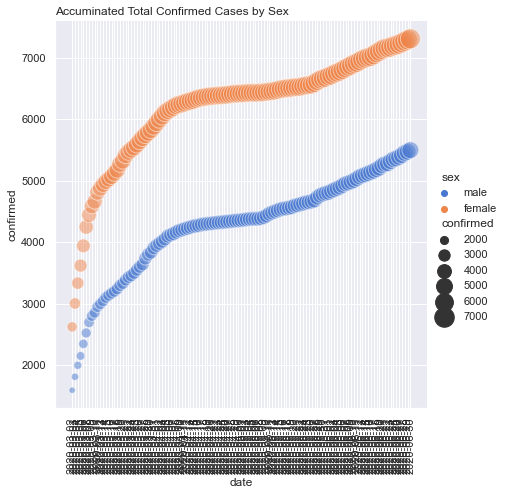

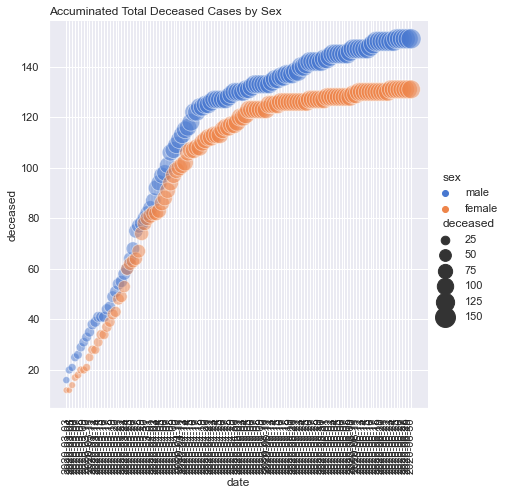

In [202]:
# Making a new assignment

df_daily_gender  = time_gender.copy()

r, d = df_daily_gender.shape
for i in range(2, r):              # skip the first row
    for j in range(3,d) :          # skip the first two columns
        df_daily_gender.iloc[i,j]   = df_daily_gender.iloc[i,j] - time_gender.iloc[(i-2),j]

# save the daily output to file
# file_name1='/kaggle/working/TimeGender_daily.csv'
# df_daily_gender.to_csv(file_name1, sep=',', encoding='utf-8')

# Plot accuminated total confirmed cases by sex
sns.set(style="darkgrid")
sns.relplot(x="date", y="confirmed", hue="sex", size="confirmed",
            sizes=(40, 400), alpha=.5, palette="muted", height=6, data=time_gender)
plt.title('Accuminated Total Confirmed Cases by Sex', loc = 'left', fontsize = 12)
plt.xticks(rotation=90)

# # Plot daily confirmed cases by sex
# sns.set(style="darkgrid")
# sns.relplot(x="date", y="confirmed", hue="sex", size="confirmed",
#             sizes=(40, 400), alpha=.5, palette="muted", height=6, data=df_daily_gender[df_daily_gender["date"] > '2020-03-02'])
# plt.title('Daily Confirmed Cases by Sex', loc = 'left', fontsize = 12)
# plt.xticks(rotation=90)

# Plot accuminated total of deceased cases by Sex
sns.set(style="darkgrid")
sns.relplot(x="date", y="deceased", hue="sex", size="deceased",
            sizes=(40, 400), alpha=.5, palette="muted",
            height=6, data=time_gender[time_gender["date"] > '2020-03-02'])
plt.title('Accuminated Total Deceased Cases by Sex', loc = 'left', fontsize = 12)
plt.xticks(rotation=90)

# # Plot Daily deceased cases by Sex
# sns.set(style="darkgrid")
# sns.relplot(x="date", y="deceased", hue="sex", size="deceased",
#             sizes=(40, 400), alpha=.5, palette="muted",
#             height=6, data=df_daily_gender[df_daily_gender["date"] > '2020-03-02'])
# plt.title('Daily Deceased Cases by Sex', loc = 'left', fontsize = 12)
# plt.xticks(rotation=90)

# Create WordCloud for infection case texts

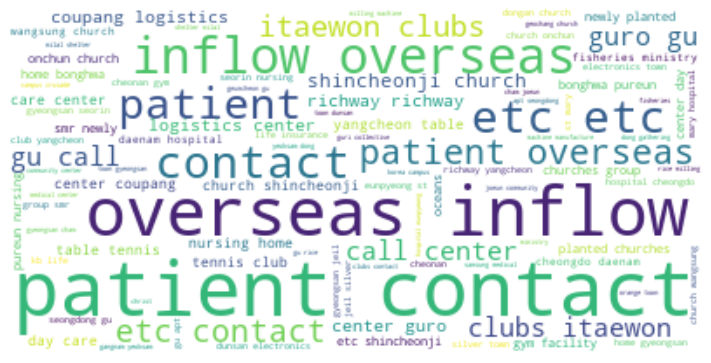

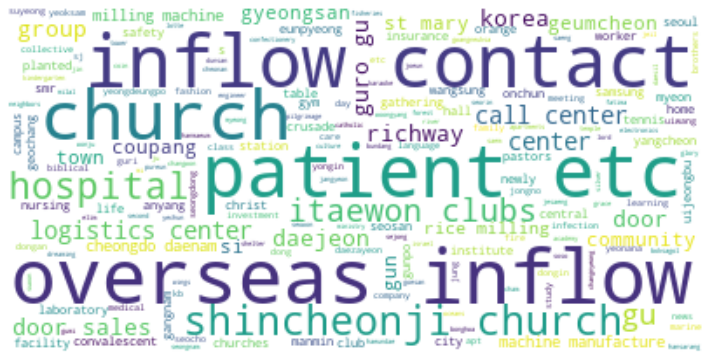

In [203]:
# Defining a wordcloud function

def wordcloud_column(dataframe):
    from wordcloud import WordCloud, STOPWORDS 
 
    comment_words = ' '
    stopwords = set(STOPWORDS) 
  
    # iterate through the csv file 
    for k in range(len(dataframe)):
        # typecaste each val to string 
        val = str(dataframe.iloc[k,0]) 
        # split the value 
        tokens = val.split()
    
        # Converts each token into lowercase 
        for i in range(len(tokens)): 
            tokens[i] = tokens[i].lower() 
          
        for words in tokens: 
            comment_words = comment_words + words + ' '
  
    # lower max_font_size
    wordcloud = WordCloud(width=400, height=200,background_color ='white', max_font_size=60).generate(comment_words)
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Find the word cloud for infection case in Patientinfo file
df_patient = pd.read_csv('/Users/Aurimas/Documents/Python/TC_projects/Covid-19/PatientInfo.csv')
df_reason  = df_patient[['infection_case']]
df_reason  = df_reason[(df_reason['infection_case'].notna())]
wordcloud_column(df_reason)

# Find the word cloud for infection case in Case file
df_case = pd.read_csv('/Users/Aurimas/Documents/Python/TC_projects/Covid-19/Case.csv')
df_case = df_case[['infection_case']]
df_case = df_case[(df_case['infection_case'].notna())]
wordcloud_column(df_case)

## The most current statistics change by population within provinces

In [209]:
# Creating a legend
legend_html = '''
        <div style="position: fixed; bottom: 300px; left: 50px; width: 160px; height: 110px; 
                    background-color: white; border:2px solid grey; z-index:9999; font-size:14px;"
                    >&nbsp; <b>Legend</b> <br>
                    &nbsp; Confirmed < 100 &nbsp&nbsp&nbsp; 
                        <i class="fa fa-circle" style="font-size:14px;color:#ff9900"></i><br>
                    &nbsp; Confirmed < 1000 &nbsp; 
                        <i class="fa fa-circle" style="font-size:14px;color:#cc33ff"></i><br>
                    &nbsp; Confirmed < 3000 &nbsp; 
                        <i class="fa fa-circle" style="font-size:14px;color:#ff0000"></i><br>
                    &nbsp; Confirmed >= 3000
                        <i class="fa fa-circle" style="font-size:14px;color:#660000"></i>
        </div>
        ''' 

def color(total):
    # Color range
    col_100  = "#ff9900"
    col_1000 = "#cc33ff"
    col_3000 = "#ff0000"
    over     = "#660000"
    if (total < 100):   
            rad = total/10
            color = col_100
    elif (total < 1000): 
            rad = min(total/10, 20)
            color = col_1000
    elif (total < 3000): 
            rad = min(total/10, 30)
            color = col_3000
    else: 
            rad = 35
            color = over
    return rad, color

# read the region coordinates from region.csv

import folium
from   folium import plugins

df_current = time_province[time_province['date']==time_province['date'].max()]
df_row = df_current.join(region.set_index('city')[['latitude','longitude']], on='province')

# map0 = folium.Map(location=[35.7982008,125.6296572], control_scale=True, tiles='Stamen Toner', zoom_start=7)
map0 = folium.Map(location=[35.7982008,125.6296572], control_scale=True, zoom_start=7)
folium.TileLayer('openstreetmap').add_to(map0)
folium.TileLayer('CartoDB positron',name='Positron').add_to(map0)
folium.TileLayer('CartoDB dark_matter',name='Dark Matter').add_to(map0)
folium.TileLayer('Stamen Terrain',name='Terrain').add_to(map0)
folium.TileLayer('Stamen Toner',name='Toner').add_to(map0)
# Enable the layer control 
folium.LayerControl().add_to(map0)
# Enable Expand fullscreen feature
plugins.Fullscreen( position='topleft', title='Expand', title_cancel='Exit', force_separate_button=True ).add_to(map0) 
map0.get_root().html.add_child(folium.Element(legend_html))

for index, row in df_row.iterrows():
    date      = row['date']
    confirmed = row["confirmed"]
    deceased  = row["deceased"]
    released  = row['released']
    province  = row["province"]
    lat   = row["latitude"]
    long  = row["longitude"]
    
    # generate the popup message that is shown on click.
    popup_text = "<b>Date:</b> {}<br><b>Province: </b>{}<br><b>Confirmed:</b> {}<br><b>Deceased: </b>{}"
    popup_text = popup_text.format(date, province, confirmed, deceased)          
    
    # select colors and radius
    rad, col = color(confirmed)
    folium.CircleMarker(location=(lat,long), radius = rad, color=col, popup=popup_text, 
                        opacity= 4.0, fill=True).add_to(map0)

map0.save('SKConfirmed_Mar20.html')
display(map0)

## Timeline of the spread of the virus with increaing populations over time

In [208]:
# Making new assignments
df_data = time_province[time_province['date']>='2020-02-18']
df_row = df_data.join(region.set_index('city')[['latitude','longitude']], on='province')

from folium.plugins import TimestampedGeoJson

map1 = folium.Map(location=[35.7982008,125.6296572], zoom_start=7, control_scale=True, tiles='openstreetmap')
folium.TileLayer('openstreetmap').add_to(map1)
folium.TileLayer('CartoDB positron',name='Positron').add_to(map1)
folium.TileLayer('CartoDB dark_matter',name='Dark Matter').add_to(map1)
folium.TileLayer('Stamen Terrain',name='Terrain').add_to(map1)
folium.TileLayer('Stamen Toner',name='Toner').add_to(map1)
# Enable the layer control 
folium.LayerControl().add_to(map1)
# Enable Expand fullscreen feature
plugins.Fullscreen( position='topleft', title='Expand', title_cancel='Exit', force_separate_button=True ).add_to(map1) 
map1.get_root().html.add_child(folium.Element(legend_html))

features = []
for index, row in df_row.iterrows():
    date      = row['date']
    confirmed = row["confirmed"]
    deceased  = row["deceased"]
    released  = row['released']
    province  = row["province"]
    lat       = row["latitude"]
    long      = row["longitude"]
    rad, col = color(confirmed)
    popup_text = "<b>Date</b>:{}<br><b>Region:</b> {}<br><b>Confirmed: </b>{}"
    popup_text = popup_text.format(date, province, confirmed)
    feature = {
            'type': 'Feature',
            'geometry': {
                'type':'Point', 'coordinates':[long, lat]},
                'properties': {
                    'time': date.__str__(),
                    'style': {'color' : col},
                    'popup': popup_text,
                    'icon': 'circle',
                'iconstyle':{
                    'fillColor': col,
                    'fillOpacity': 0.8,
                    'fill': 'true',
                    #'stroke': 'true',
                    'radius': rad}
                    }
                }
    features.append(feature)
TimestampedGeoJson(
        {'type': 'FeatureCollection',
        'features': features}
        , period='P1D'
        , add_last_point=True
        , auto_play=True
        , loop=True
        , max_speed=1
        , loop_button=True
        , date_options='YYYY-MM-DD'
        , time_slider_drag_update=True).add_to(map1)

filename='SKGrowth_Mar20Time.html'
map1.save(filename)
display(map1)

# Conclusion

<i>From **patient_info** data we observe:</i>

**1)** There is higher chance of infection and mortality as the age group of the patient increases.

**2)** There was higher mortality rate of males than females.

**3)** In South Korea, highest infection and mortality rate came from Daegu, Ganwon-do and Gyeongsangbuk-do, where there was the uncontrolled spread of the virus due to shincheonji (religious cult).

[Insights from EDA]

## Age

* 20s are the most infected age group (27.80% to total)
* Older than 70 are the most deceased age group (48.08% to total)
* Countries need to separate the two groups while preventing spreads as a whole

## Region

* The more populated, the more cases in general (excluding 2 outliers)
* What's riskier are community-level gatherings like religious events
* Countries better try to prevent them and detect the particular event if it occured

## Sex

* Any significant difference between sexes was not found
* Females seem more prone to be infected (58.91% VS. 41.09%)
* Males seem more prone to be deceased (51.92% VS. 48.08%)

## Test

* The number of tests and negative/released cases have kept increasing linearly
* Confirmed/deceased cases show more dynamic slope changes than above three while increasing
* Daily confirmed cases have the second spike around 2020-05-11 (a probable sign of the 2nd wave)

## Path

* Up to 60% cases seemed to be transmitted by 1 specific gathering (Sinchonji Church in Daegu)
* The following paths are also from groups like workplaces
* The imported cases from abroad keep increasing

## Weather

* Weather-related features show no clear correlation with infections
* There is a weak negative correlation between temperature and infections (colder & more infections)
* There is a weaker positive correlation between maximun wind speed and infections (more wind & more infections)

## Patient

* Half of the logged patients have <=4 contacts with (or possible infections to) other patients before confirmed
* There are outliers with more than 1,000 contacts though
* The average number of contacts by a patient per day has decreased as time went by 

## Seoul (the capital of S.Korea)

* Floating population shows a positive correlation with the number of infections (more floating & more infections)
* The activities of older than 60 decreased after the outbreak of COVID-19
* The absolute number of cases in each subregion is too small (<100) to draw a conclusion from

## Search

* Searching on pneumonia was prior to that on COVID-19
* Increase of COVID-19 searches has been ahead of the actual increase of confirmed cases
* The searching itself and the number of daily new cases have decreased (with a small spike around 2020-05-11)

## Policy

* Level 3 (2nd highest) caution on infectious diseases was implemented proactively
* Policies on immigration have kept updated for more countries while the borders are open
* Educational measures are yet shifting 'complete closure' > 'online classes' > 'physical classes (some graders)'
* Activity (discarded from the original dataset as of 2020-06-30)
* Half of the documented patients have <=4 activity logs for 2 weeks before confirmed
* The most visited places are hospitals followed by stores, public transportations and restaurants
* Countries should apply a lot stricter preventing measures on these places

# 4

# Forecasting and improvents

## Linear Regression / Naive / Average

* Linear regression(LR) model on search trends could match a general trend of infections
* Naive forecasting (by 1 last observation) learns the latest change on the fly
* Moving average forecasting (by 7 latest observations) works better than LR and naive
* The ensembled model of the three gives the best score

## ARIMA

* ARIMA requires basic understandings on auto regression, deferencing and moving average to set 3 parameters
* A grid search can yeild a better performance than the model with empirically picked parameters
* A Rolling-based model learning every prediction as the latest observation tends to underestimate the truth

## Prophet - basics

* The data with 1 infection cycle of increase and decrease are not enough to feed Prophet
which is mainly for catching repetitive cyclic and/or seasonal patterns with a global trend
* S.Korea and some countries have only 1 cycle as they are now fighting against the 1st wave of COVID-19
* Many others have less than 1 cycle as their curves are not flattening yet (meaning they are in the earlier phase)

## Prophet - space to time

* We clustered the countries by recent_to_max equation
which is the ratio of the latest daily cases to the max daily cases in a country
* Then used the data of the countries with <0.1 ratio (<10% to max) to make 1 long time series
* Prophet learned the general cycle of spreading with a reasonable accuracy
  * but the scale of predictions is about half of the truth 
  * we scaled and amplified them to match the top with 100% and bottom with 0% daily confirmed cases ratio

## Prophet - time to space

* These predictions could give insights to the countries in the earlier phase
  * on how long does it take to quit the 1 cycle of spreading 
    * to prepare necessary resources
    * to design a longterm exit plan
    * to make an effort to shorten the expected time to quit
* For the country with median of recent_to_max
  * the predictions match with the truth in terms of exponential increasing to the peak
  * the spreading pace from first case to the peak also is aligned with the truth
  * regarding this, the expected time to approach the late phase is about 1.5 months